In [1]:
%matplotlib inline
%config IPython.matplotlib.backend = "retina"
from matplotlib import rcParams
rcParams["figure.dpi"] = 150
rcParams["savefig.dpi"] = 150

In [2]:
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf

session = tf.Session()

/Users/dforeman/anaconda/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [3]:
def get_param_for_value(value, min_value, max_value):
    if np.any(value <= min_value) or np.any(value >= max_value):
        raise ValueError("value must be in the range (min_value, max_value)")
    return np.log(value - min_value) - np.log(max_value - value)

def get_value_for_param(param, min_value, max_value):
    return min_value + (max_value - min_value) / (1.0 + np.exp(-param))

def get_bounded_variable(name, value, min_value, max_value, dtype=tf.float64):
    param = tf.Variable(get_param_for_value(value, min_value, max_value), dtype=dtype, name=name + "_param")
    var = min_value + (max_value - min_value) / (1.0 + tf.exp(-param))
    log_jacobian = tf.log(var - min_value) + tf.log(max_value - var) - np.log(max_value - min_value)
    return param, var, tf.reduce_sum(log_jacobian), (min_value, max_value)

In [4]:
np.random.seed(42)
t = np.linspace(0, 6, 5000)[:3000]
yerr = 0.5 + np.zeros_like(t)
ivar = 1.0 / yerr**2

T = tf.float64

log_prob = tf.constant(0.0, dtype=T)
nl = 2
nn = 3
nmodes = (2*nn+1)*nl


# Deal with bounded variables
log_numax_param, log_numax, log_jac, log_numax_range = get_bounded_variable("log_numax", np.log(200.0), np.log(150.0), np.log(300.0), dtype=T)
log_prob += log_jac

log_numax_l_param, log_numax_l, log_jac, log_numax_l_range = get_bounded_variable("log_numax_l", np.log(200.0) + np.zeros(nl), np.log(150.0), np.log(300.0), dtype=T)
log_prob += log_jac

log_dnu_param, log_dnu, log_jac, log_dnu_range = get_bounded_variable("log_dnu", np.log(17.0), np.log(15.0), np.log(30.0), dtype=T)
log_prob += log_jac

log_numax_sig2_param, log_numax_sig2, log_jac, log_numax_sig2_range = get_bounded_variable("log_numax_sig2", 0.0, -5.0, 5.0, dtype=T)
log_prob += log_jac

# u_param, u, log_jac, u_range = get_bounded_variable("u", np.random.rand(nmodes), 0.0, 1.0, dtype=T)
# log_prob += log_jac

uy = tf.Variable(np.random.randn(2*nmodes), dtype=T)
log_prob -= 0.5 * tf.reduce_sum(tf.square(uy))
norm = tf.sqrt(uy[:nmodes]**2 + uy[nmodes:]**2)
ux1 = uy[:nmodes] / norm
ux2 = uy[nmodes:] / norm

log_amp = tf.Variable(np.log(np.random.uniform(0.01, 0.02, nl)), dtype=T, name="log_amp")
log_width = tf.Variable(np.log(25.0), dtype=T, name="log_width")
curve = tf.Variable(0.001, dtype=T, name="curve")

session.run(tf.global_variables_initializer())

# Get frequencies
nn = 3
dn = np.arange(-nn, nn+1)
l = np.arange(nl)
numax = tf.exp(log_numax)
numax_l = tf.exp(log_numax_l)
dnu = tf.exp(log_dnu)

nu = (numax_l + 0.5*l*dnu)[:, None] + dnu*(dn + curve*dn**2)[None, :]
echelle = [tf.transpose(tf.mod(nu, dnu)), tf.transpose(nu)]

# Get amplitudes
amp = tf.exp(log_amp[:, None]-0.5*(nu - numax)**2 * tf.exp(-2*log_width))

# Build the design matrix
nu_flat = tf.reshape(nu, (-1,))
amp_flat = tf.reshape(amp, (-1,))
arg = 2 * np.pi * nu_flat[None, :] * t[:, None]
design = tf.concat([tf.cos(arg), tf.sin(arg)], axis=1)
Lambda = tf.concat([amp_flat, amp_flat], axis=0)

# Simulate some data
w = tf.concat([
    tf.sqrt(amp_flat) * ux1,
    tf.sqrt(amp_flat) * ux2,
], axis=0)
model_y = tf.squeeze(tf.matmul(design, w[:, None]))
y = session.run(model_y) + yerr * np.random.randn(len(t))

log_prob -= 0.5*tf.reduce_sum(tf.square((y - model_y)/yerr))

# Prior on numax_l
# log_prob -= 0.5*tf.reduce_sum(tf.square(numax_l - numax) * tf.exp(-log_numax_sig2) + log_numax_sig2)

loss = -log_prob

# For predictions

var_list = [
    log_numax_param, log_dnu_param, log_numax_l_param, curve, log_amp, log_width, uy,
]
opt = tf.contrib.opt.ScipyOptimizerInterface(loss, var_list)

Instructions for updating:
Use the retry module or similar alternatives.


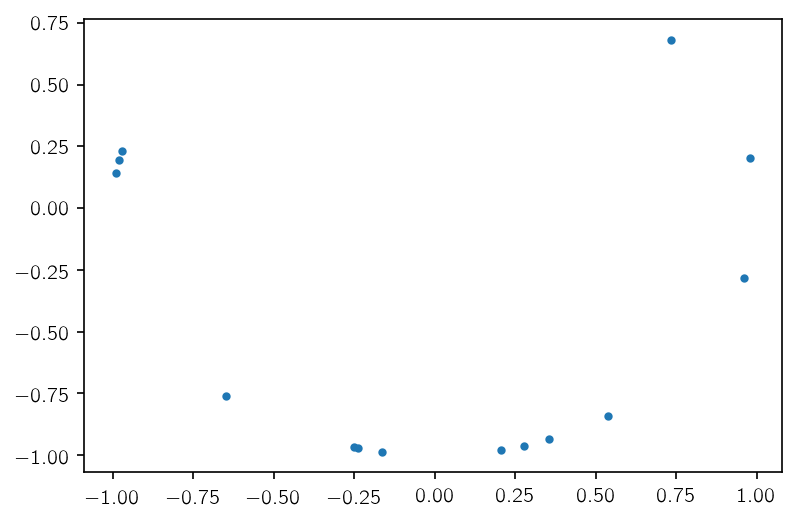

In [5]:
plt.plot(*session.run([ux1, ux2]), ".");

In [6]:
session.run(amp)

array([[0.00134618, 0.00423975, 0.00845595, 0.01065052, 0.00844813,
        0.0042085 , 0.00131299],
       [0.00464238, 0.01161635, 0.01839858, 0.01839434, 0.01157617,
        0.00457321, 0.00113095]])

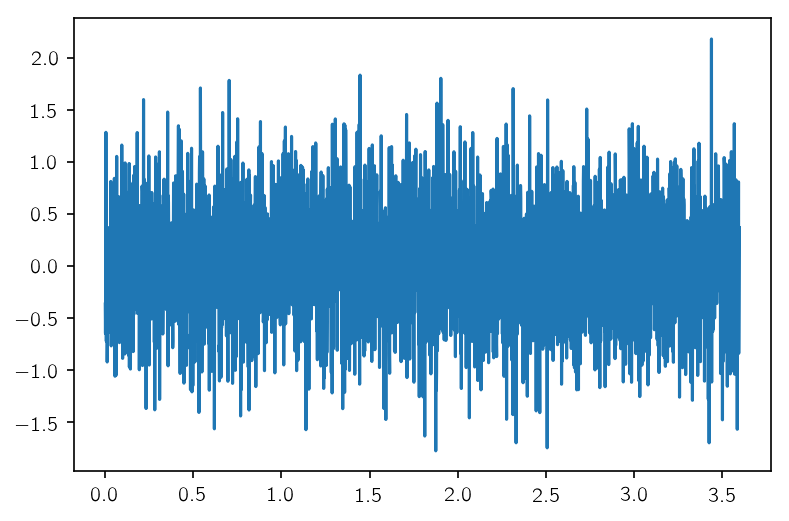

In [7]:
plt.plot(t, y)

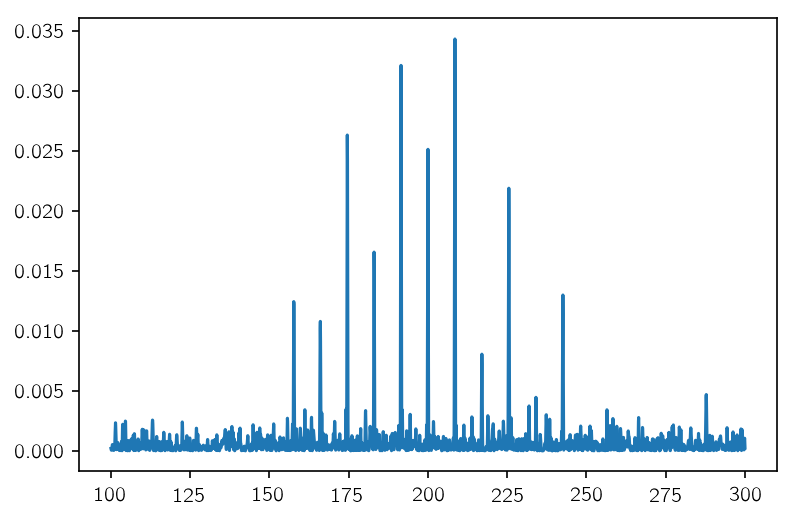

In [8]:
from astropy.stats import LombScargle
m = LombScargle(t, y, yerr)
f, p = m.autopower(minimum_frequency=100, maximum_frequency=300, nyquist_factor=100)
plt.plot(f, p);

In [9]:
session.run(var_list)

[-0.34317886798935926,
 -1.5124752855450794,
 array([-0.34317887, -0.34317887]),
 0.001,
 array([-4.54214694, -3.9379125 ]),
 3.2188758248682006,
 array([ 0.49671415, -0.1382643 ,  0.64768854,  1.52302986, -0.23415337,
        -0.23413696,  1.57921282,  0.76743473, -0.46947439,  0.54256004,
        -0.46341769, -0.46572975,  0.24196227, -1.91328024, -1.72491783,
        -0.56228753, -1.01283112,  0.31424733, -0.90802408, -1.4123037 ,
         1.46564877, -0.2257763 ,  0.0675282 , -1.42474819, -0.54438272,
         0.11092259, -1.15099358,  0.37569802])]

In [10]:
session.run(log_prob)

-1487.8926241198371

In [11]:
opt.minimize(session)

INFO:tensorflow:Optimization terminated with:
  Message: b'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
  Objective function value: 1482.627896
  Number of iterations: 55
  Number of functions evaluations: 63


In [12]:
session.run(log_prob)

-1482.6278964163157

In [13]:
session.run(var_list)

[-0.4314473638647607,
 -1.513440233178407,
 array([-0.34326425, -0.34303154]),
 0.0009711850080792135,
 array([-4.56286381, -3.72649323]),
 3.1825694261950646,
 array([ 0.48933655, -0.15484328,  0.65873901,  1.50096817, -0.35155395,
        -0.22542097,  1.53461558,  0.78104855, -0.46461286,  0.48614416,
        -0.40221889, -0.4653623 ,  0.26478326, -1.87702664, -1.69761794,
        -0.54872934, -0.98319109,  0.29989783, -0.85969061, -1.39088729,
         1.46371585, -0.12810222,  0.07478836, -1.42024525, -0.58152851,
         0.07943948, -1.12715777,  0.40048765])]

In [14]:
hess = session.run(tf.hessians(log_prob, var_list))

In [15]:
import simple_hmc
var = 1.0 / np.abs(np.concatenate([np.diag(np.atleast_2d(h)) for h in hess]))
metric = simple_hmc.DiagonalMetric(len(var), var)
results = simple_hmc.tf_simple_nuts(session, log_prob, var_list, 2000, 0.01, metric=metric)

100%|██████████| 2000/2000 [04:59<00:00,  6.75it/s]


In [16]:
results[-1]

0.7567647130591515

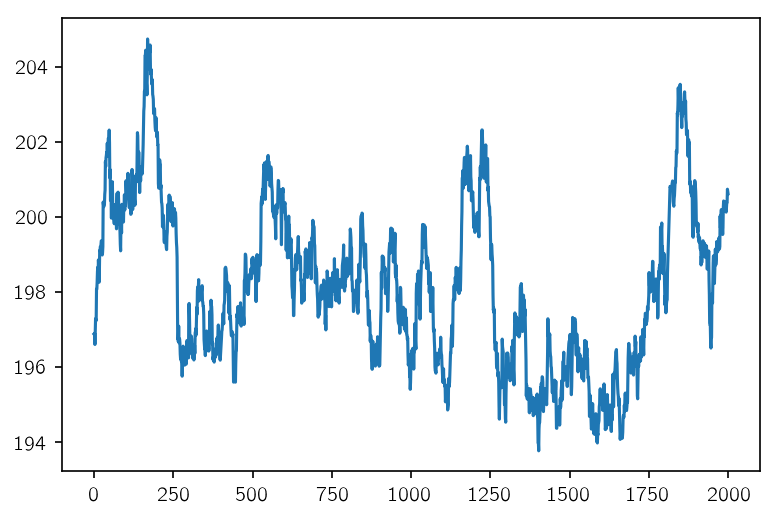

In [17]:
plt.plot(np.exp(get_value_for_param(results[0][:, 0], *log_numax_range)))

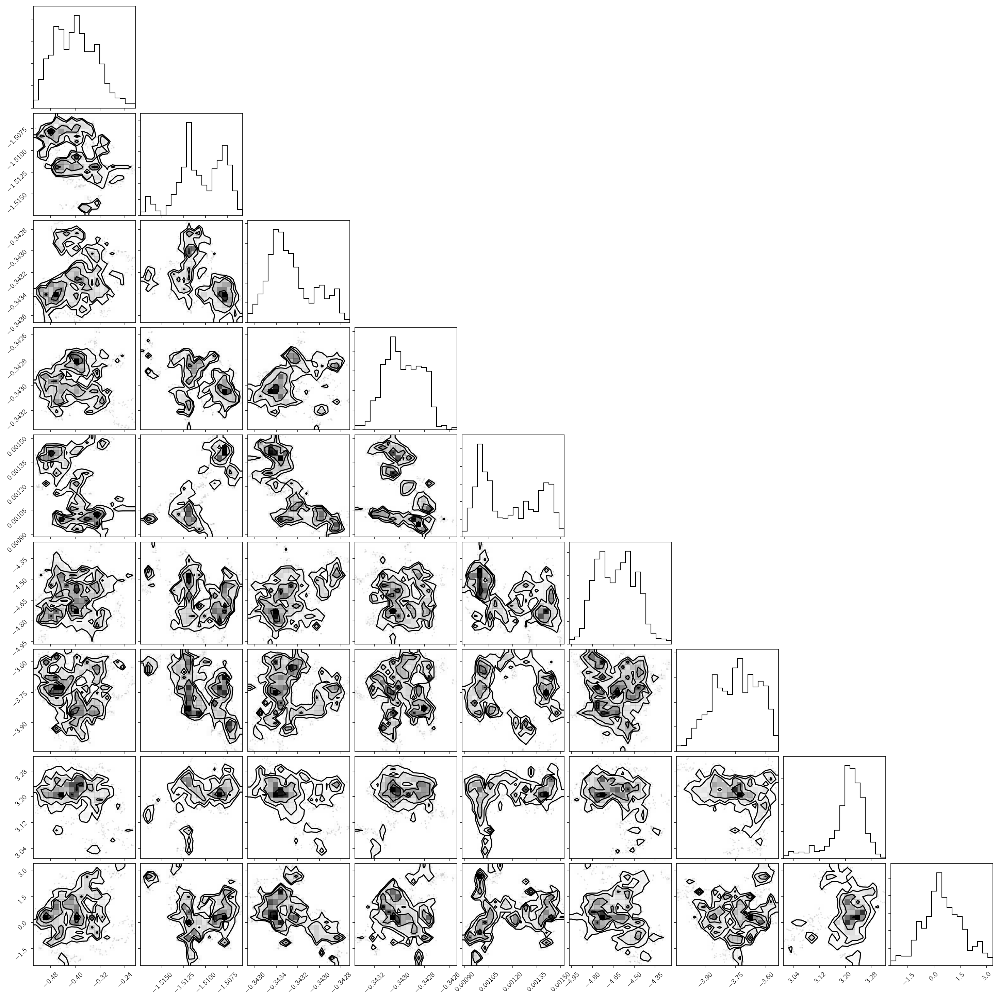

In [18]:
import corner
corner.corner(results[0][:, :9]);

In [19]:
# corner.corner(results[0][:, 9:]);

In [20]:
# metric2 = simple_hmc.DiagonalMetric(len(var), np.var(results[0], axis=0))
# results2 = simple_hmc.tf_simple_nuts(session, log_prob, var_list, 10, 0.01, metric=metric2)

In [21]:
# results2[-1]

In [22]:
metric2 = simple_hmc.DenseMetric(len(var), np.cov(results[0], rowvar=0))
results2 = simple_hmc.tf_simple_nuts(session, log_prob, var_list, 2000, 0.02, metric=metric2)

100%|██████████| 2000/2000 [05:18<00:00,  6.75it/s]


In [23]:
results2[-1]

0.701123357282758

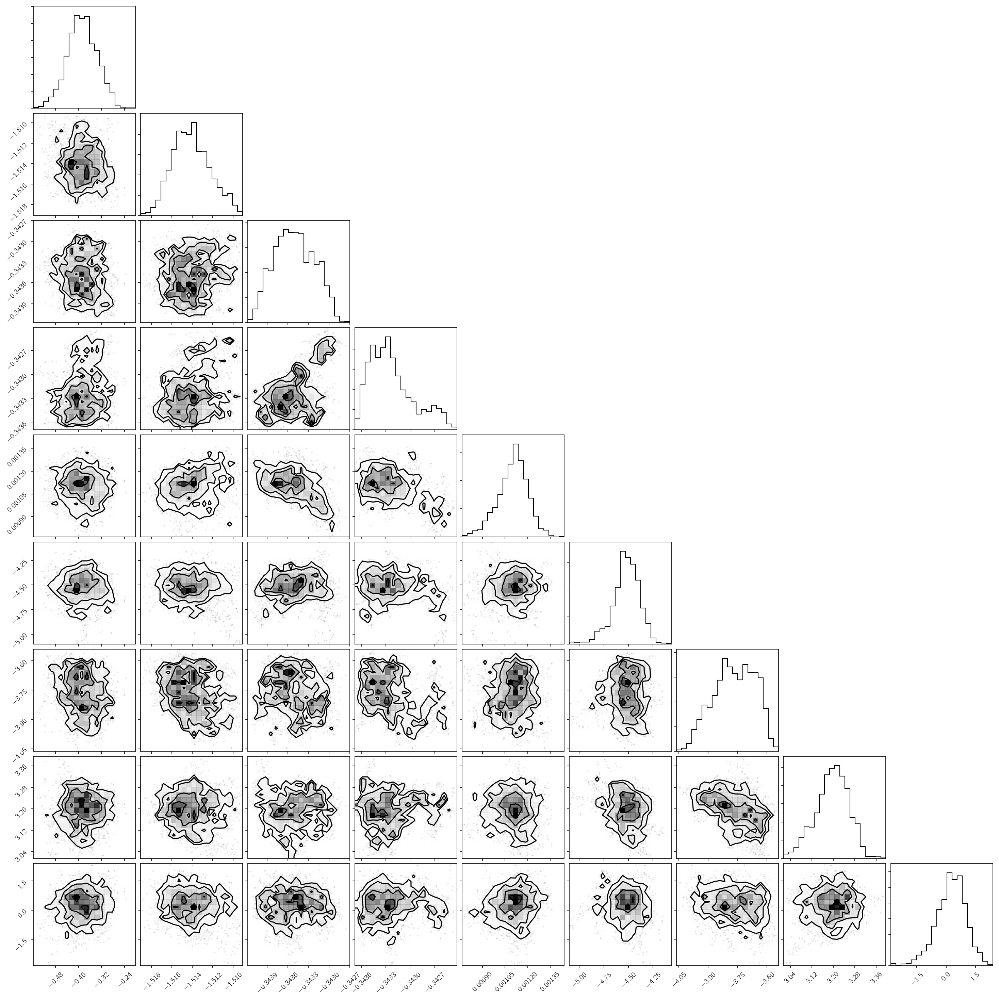

In [24]:
corner.corner(results2[0][:, :9]);

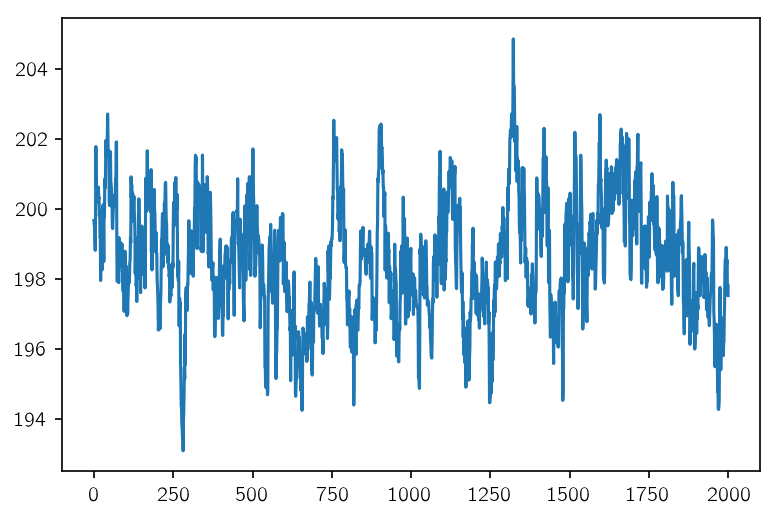

In [27]:
plt.plot(np.exp(get_value_for_param(results2[0][:, 0], *log_numax_range)))

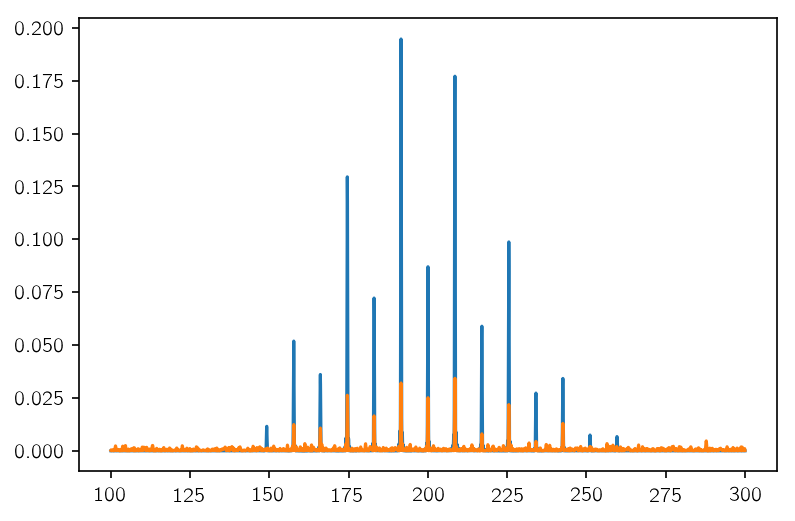

In [12]:
m = LombScargle(t, session.run(model_y), yerr)
f, p = m.autopower(minimum_frequency=100, maximum_frequency=300, nyquist_factor=100)
plt.plot(f, p);

m = LombScargle(t, y, yerr)
f, p = m.autopower(minimum_frequency=100, maximum_frequency=300, nyquist_factor=100)
plt.plot(f, p);


In [29]:
metric3 = simple_hmc.DenseMetric(len(var), np.cov(results2[0], rowvar=0))
results3 = simple_hmc.tf_simple_nuts(session, log_prob, var_list, 2000, 0.02, metric=metric3)

100%|██████████| 2000/2000 [05:04<00:00,  6.65it/s]


In [30]:
results3[-1]

0.6988111084659704

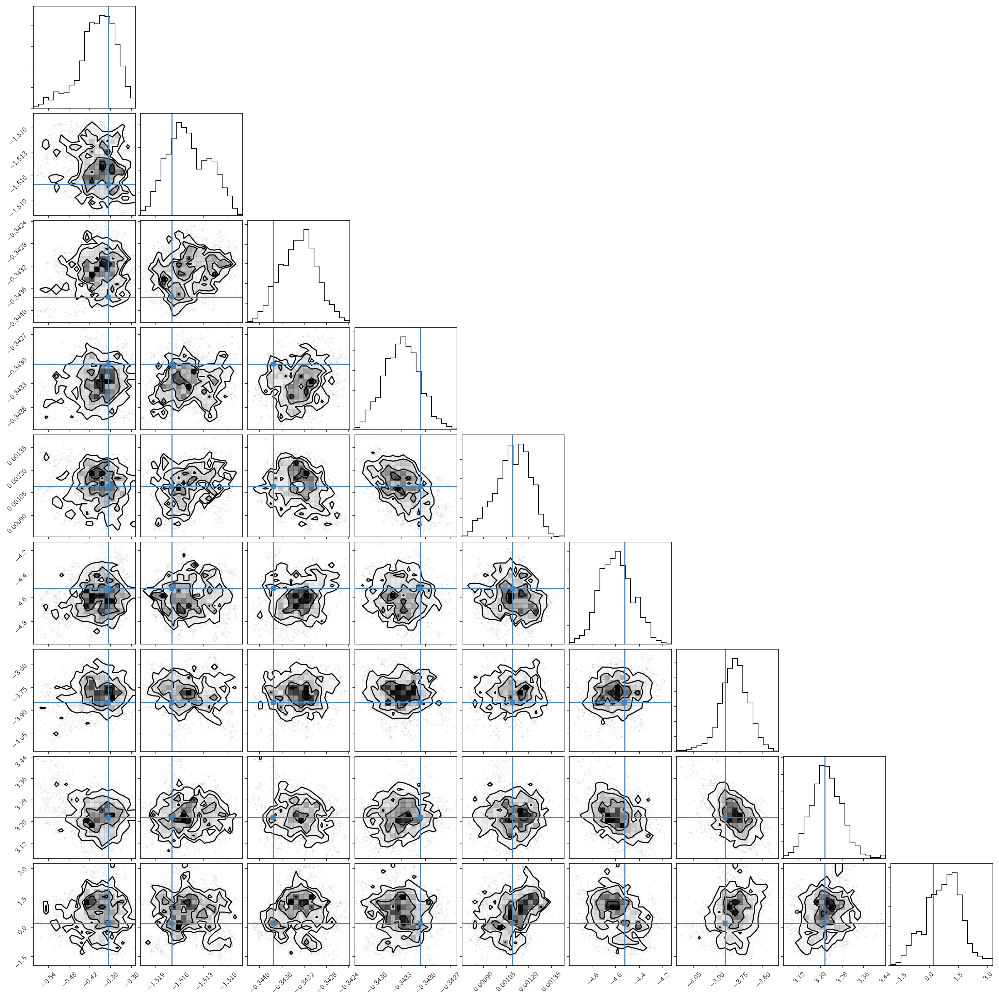

In [31]:
corner.corner(results3[0][:, :9], truths=results3[0][np.argmax(results3[1])][:9]);

In [32]:
corner.corner(results3[0][:, 9:]);

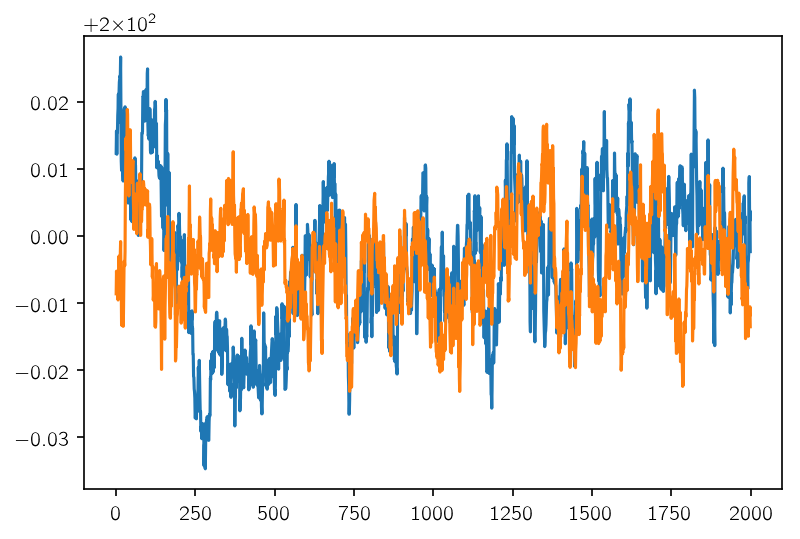

In [33]:
plt.plot(np.exp(get_value_for_param(results3[0][:, 2:4], *log_numax_range)));

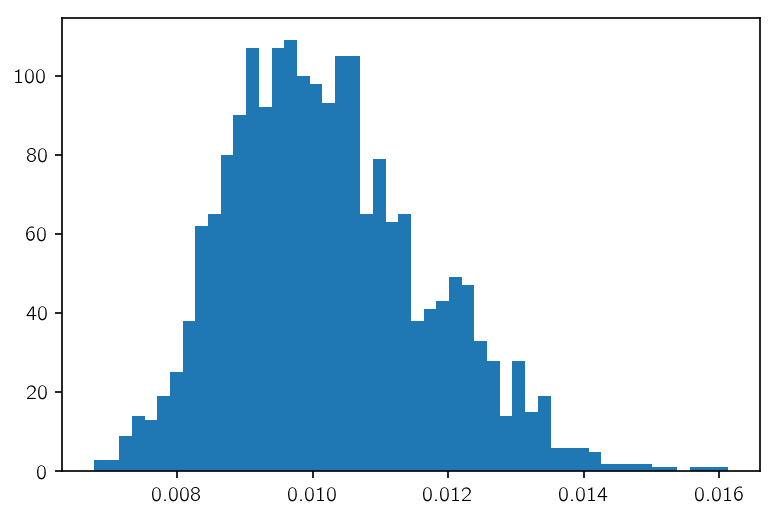

In [34]:
plt.hist(np.exp(results3[0][:, 5]), 50);

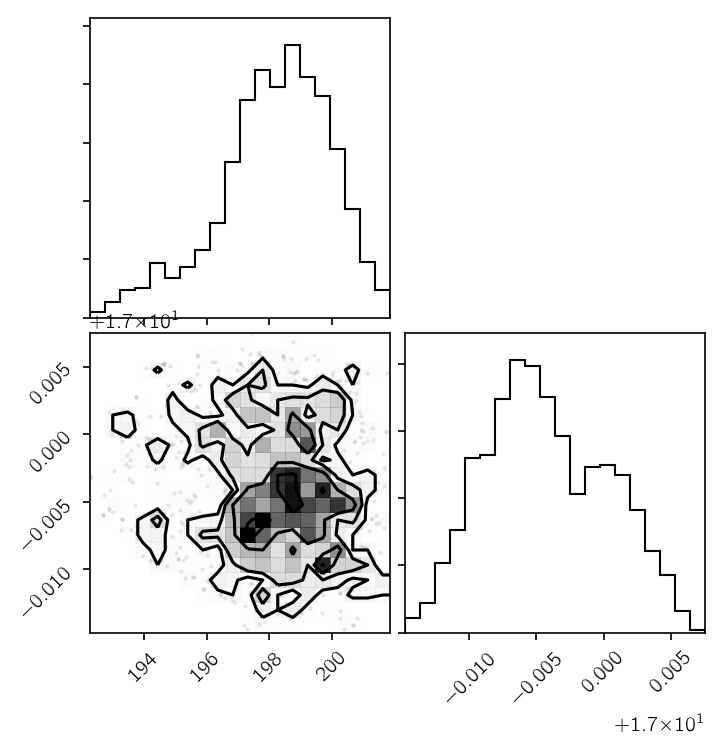

In [35]:
corner.corner(
    np.transpose([
        np.exp(get_value_for_param(results3[0][:, 0], *log_numax_range)),
        np.exp(get_value_for_param(results3[0][:, 1], *log_dnu_range)),
    ])
);

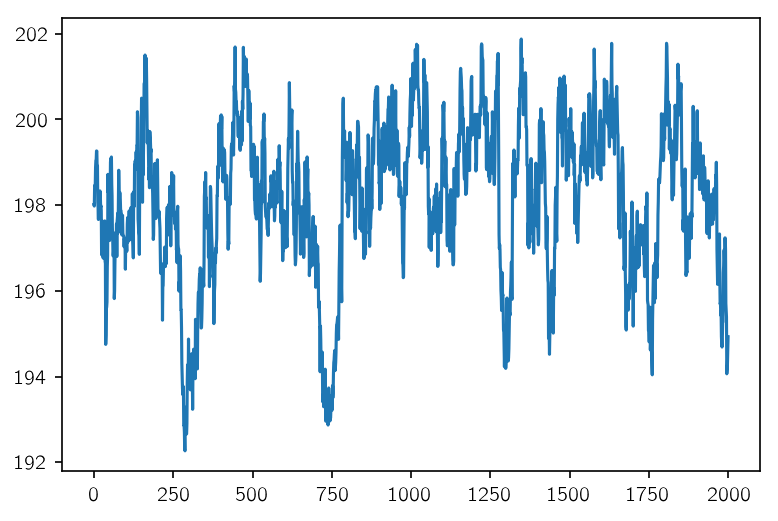

In [36]:
plt.plot(np.exp(get_value_for_param(results3[0][:, 0], *log_numax_range)))

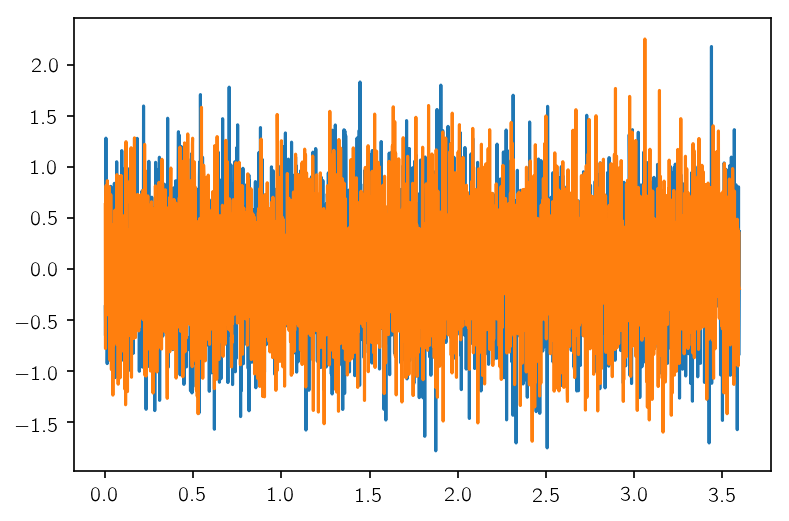

In [37]:
plt.plot(t, y)
plt.plot(t, session.run(model_y) + yerr*np.random.randn(len(t)));


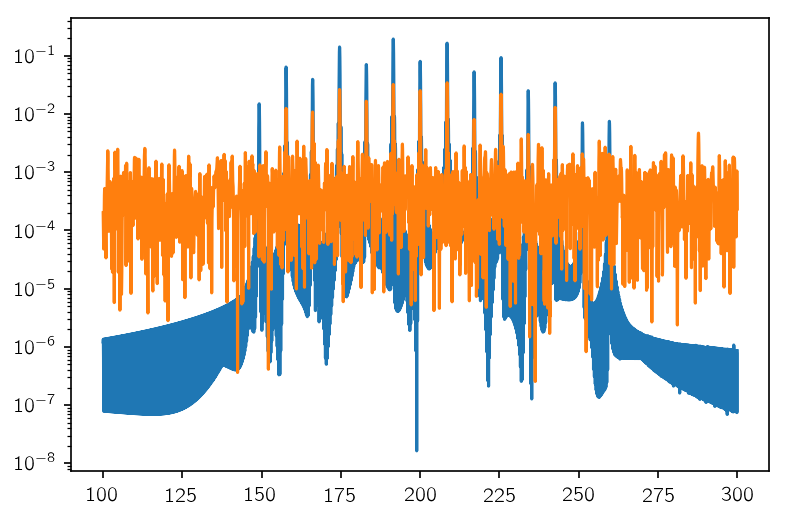

In [38]:
m = LombScargle(t, session.run(model_y), yerr)
f, p = m.autopower(minimum_frequency=100, maximum_frequency=300, nyquist_factor=100)
plt.plot(f, p);

m = LombScargle(t, y, yerr)
f, p = m.autopower(minimum_frequency=100, maximum_frequency=300, nyquist_factor=100)
plt.semilogy(f, p);


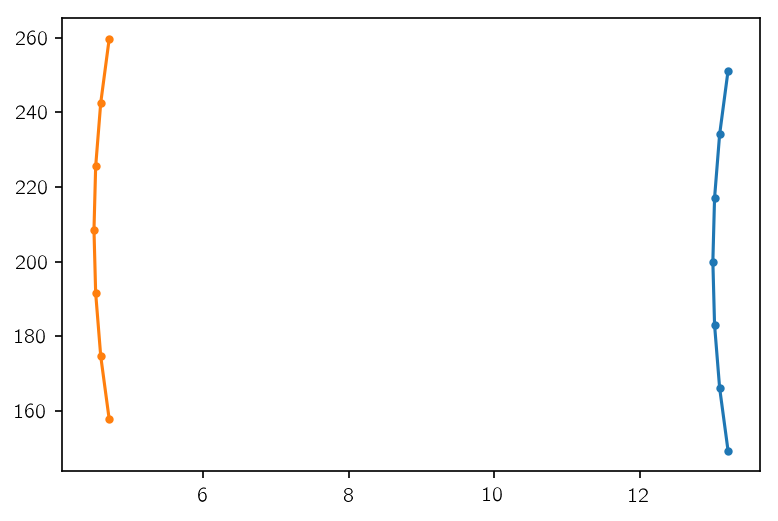

In [39]:
plt.plot(*session.run(echelle), ".-")

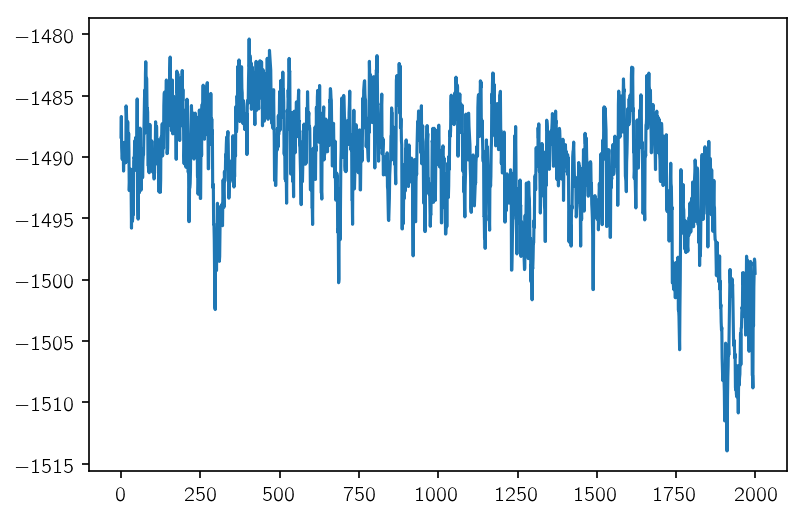

In [40]:
plt.plot(results3[1]);

In [41]:
results3[0][np.argmax(results3[1])]

array([-3.66769256e-01, -1.51701224e+00, -3.43757777e-01, -3.43065408e-01,
        1.09107383e-03, -4.52315911e+00, -3.84568506e+00,  3.21648571e+00,
        1.84968924e-01, -2.97718427e-02,  5.89695368e-01,  4.35102750e-01,
       -5.08988001e-01, -3.32563296e-01,  1.25107032e+00,  1.10233584e+00,
       -1.80934090e+00,  2.89154720e-01, -3.30385648e-01, -5.87129793e-01,
        3.88179809e-01, -8.75340597e-01, -3.05182359e-01, -5.87415862e-01,
       -1.19969228e+00, -1.22685223e-02, -8.31446848e-01, -7.48349522e-01,
        1.36671872e+00,  1.46827972e-01,  9.58997312e-02, -8.79620173e-01,
       -4.74992867e-01,  1.11344354e-01, -1.83465459e+00,  1.10319430e+00])